In [1]:
import pandas as pd

In [2]:
# Analysis of profiles.csv

In [3]:
data = pd.read_csv('../data/profiles.csv', sep='\t')
data.head()

,current_location,registration,company,address,ssn,residence,mail,name,imei,username,job,user_id
0,NaN,2022/03/25,Norris-Martinez,"284 Kline Row Apt. 100\nDuncanland, ID 10765",226-46-0969,NaN,stevenchan@gmail.com,Sherry Harris MD,3590433799317661503,alexa85,NaN,1222
1,"(Decimal('16.0116665'), Decimal('-11.489756'))",2018-12-03,Rojas Ltd,"9075 Daniel Route Apt. 306\nBlackburnshire, MI...",022-16-2344,NaN,thomasoscar@hotmail.com,Joshua Holt,359043379931766205,stewartmario,NaN,572
2,"(Decimal('-79.870511'), Decimal('-16.954773'))","08/18/2020, 00:00:00",Juarez-Smith,56636 Owen Mountains Apt. 205\nNew Jeffreybury...,868-87-3938,"85572 Travis Streets Suite 945\nTheresaland, V...",john36@hotmail.com,Julie Pruitt,863033069630348511,bookerdaniel,"Biochemist, clinical",1440
3,"(Decimal('7.0195475'), Decimal('-12.331289'))",2021-08-25,Armstrong-Austin,"654 Rodriguez Landing\nWest Andrewchester, NY ...",500-22-3162,"38831 Bruce Motorway Suite 571\nHaasside, ID 5...",lfitzgerald@gmail.com,Sarah Jones,8630330696303481917,hbennett,NaN,797
4,"(Decimal('-78.707758'), Decimal('-78.086388'))",2021/09/09,Diaz-Salazar,"40702 Ayers Club Apt. 763\nEast Andrewview, SD...",749-26-2817,NaN,edward35@gmail.com,Bradley Jones,359043379931766445,ntaylor,"Engineer, civil (contracting)",2515


In [4]:
# Analýza štruktúr dát ako súbory (štruktúry a vzťahy, počet, typy, …), záznamy (štruktúry, počet záznamov, počet atribútov, typy, …)

print("Info for profiles.csv:")
print(data.info())
print("Size of dataset:", data.shape)  
print("The number of missing values in each column, %:")
print(round((data.isnull().sum() / len(data)) * 100, 2))
# there are too many empty cells in some columns 
# the “job” and “residense” columns are up to 70% empty, so we can't rely on them
# in this file we have a large number of object types 
# the data in some columns is in strange formats, we will need to fix it 

Info for profiles.csv:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2524 entries, 0 to 2523
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   current_location  2398 non-null   object
 1   registration      2524 non-null   object
 2   company           2524 non-null   object
 3   address           2145 non-null   object
 4   ssn               2524 non-null   object
 5   residence         883 non-null    object
 6   mail              2524 non-null   object
 7   name              2524 non-null   object
 8   imei              2524 non-null   int64 
 9   username          2524 non-null   object
 10  job               757 non-null    object
 11  user_id           2524 non-null   int64 
dtypes: int64(2), object(10)
memory usage: 236.8+ KB
None
Size of dataset: (2524, 12)
The number of missing values in each column, %:
current_location     4.99
registration         0.00
company              0.00
address       

In [5]:
# try to find more suitable data for analysis in another file 
data_connect = pd.read_csv('../data/connections.csv', sep='\t')
data_connect.head()

,ts,imei,mwra,c.dogalize,c.android.chrome,c.android.gm,c.katana,c.android.youtube,c.UCMobile.intl,c.UCMobile.x86,c.android.vending,c.raider,c.updateassist
0,2018-05-05 10:00:00,359043379931766924,1.0,12.95007,8.60869,14.35052,15.09244,14.21099,47.19187,66.18685,36.48952,51.34268,4.11084
1,2018-05-05 10:01:00,8630330696303481206,1.0,7.80749,9.90036,12.36228,15.07827,12.60819,39.62182,57.92688,70.63466,44.98840,96.53229
2,2018-05-05 10:02:00,3590433799317661792,0.0,13.07092,9.43011,7.81807,12.39585,15.03071,30.64468,62.70584,52.61305,20.17225,35.87145
3,2018-05-05 10:03:00,863033069630348917,1.0,13.35146,13.51698,8.26784,9.55317,13.49583,44.58387,56.02815,66.47141,48.96899,56.19477
4,2018-05-05 10:04:00,3590433799317661701,1.0,14.32380,12.86550,7.19114,10.66630,8.13499,57.81464,33.75108,40.94849,62.82517,79.43138


In [6]:
# Analýza štruktúr dát ako súbory (štruktúry a vzťahy, počet, typy, …), záznamy (štruktúry, počet záznamov, počet atribútov, typy, …)

print("Info for connections.csv:")
print(data_connect.info())
print("Size of dataset:", data_connect.shape)  
print("The number of missing values in each column, %:")
print(round((data_connect.isnull().sum() / len(data)) * 100, 2))
# there are no empty cells in columns 
# in this file we have a large number of float types 
# it contains the measurement data that is most important to us

Info for connections.csv:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15156 entries, 0 to 15155
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   ts                 15156 non-null  object 
 1   imei               15156 non-null  int64  
 2   mwra               15156 non-null  float64
 3   c.dogalize         15156 non-null  float64
 4   c.android.chrome   15156 non-null  float64
 5   c.android.gm       15156 non-null  float64
 6   c.katana           15156 non-null  float64
 7   c.android.youtube  15156 non-null  float64
 8   c.UCMobile.intl    15156 non-null  float64
 9   c.UCMobile.x86     15156 non-null  float64
 10  c.android.vending  15156 non-null  float64
 11  c.raider           15156 non-null  float64
 12  c.updateassist     15156 non-null  float64
dtypes: float64(11), int64(1), object(1)
memory usage: 1.5+ MB
None
Size of dataset: (15156, 13)
The number of missing values in each column, %:


In [7]:
# Analýza jednotlivých atribútov: pre zvolené významné atribúty (min 10) analyzujte ich distribúcie a základné deskriptívne štatistiky.

data_connect.describe()
for col in data_connect.select_dtypes(include ='float64').columns:
    print(f"Atribute: {col}")
    print(f"Mean: {data_connect[col].mean():.2f}")
    print(f"Median: {data_connect[col].median():.2f}")
    print(f"Mode: {data_connect[col].mode().iloc[0]:.2f}")  
    print(f"Std: {data_connect[col].std():.2f}")
    print(f"Var: {data_connect[col].var():.2f}")

Atribute: mwra
Mean: 0.63
Median: 1.00
Mode: 1.00
Std: 0.48
Var: 0.23
Atribute: c.dogalize
Mean: 11.53
Median: 11.70
Mode: 8.02
Std: 2.41
Var: 5.79
Atribute: c.android.chrome
Mean: 9.71
Median: 9.39
Mode: 9.49
Std: 2.56
Var: 6.58
Atribute: c.android.gm
Mean: 10.36
Median: 10.32
Mode: 9.58
Std: 2.60
Var: 6.75
Atribute: c.katana
Mean: 11.00
Median: 11.20
Mode: 10.65
Std: 2.52
Var: 6.35
Atribute: c.android.youtube
Mean: 12.18
Median: 12.18
Mode: 10.63
Std: 1.91
Var: 3.64
Atribute: c.UCMobile.intl
Mean: 49.58
Median: 49.57
Mode: 15.15
Std: 12.42
Var: 154.16
Atribute: c.UCMobile.x86
Mean: 51.89
Median: 51.80
Mode: 49.08
Std: 13.25
Var: 175.68
Atribute: c.android.vending
Mean: 51.74
Median: 51.70
Mode: 11.47
Std: 12.05
Var: 145.28
Atribute: c.raider
Mean: 52.05
Median: 52.00
Mode: 42.69
Std: 12.85
Var: 165.09
Atribute: c.updateassist
Mean: 50.26
Median: 50.44
Mode: 32.93
Std: 28.80
Var: 829.23


In [8]:
# We have 500 different imeis in this connections.csv
len(data_connect.imei.unique())

500

In [9]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scipy.stats as stats

<Figure size 1000x600 with 0 Axes>

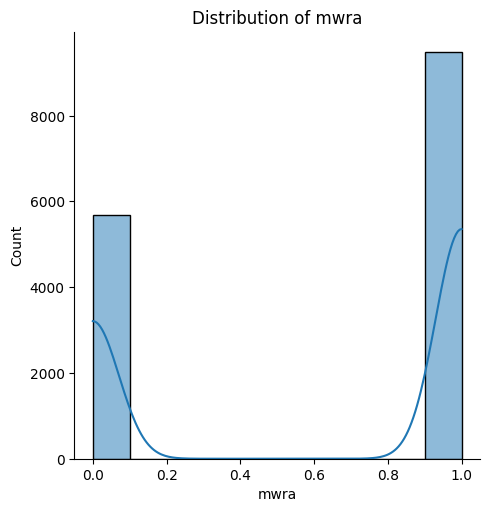

Column: mwra
  Skewness: -0.51800
  Kurtosis: -1.73168


<Figure size 1000x600 with 0 Axes>

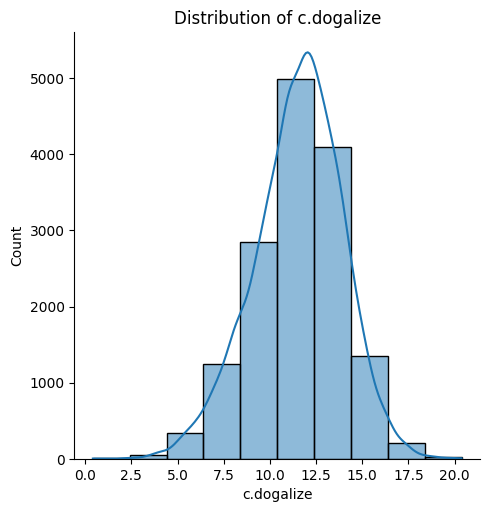

Column: c.dogalize
  Skewness: -0.30222
  Kurtosis: 0.17751


<Figure size 1000x600 with 0 Axes>

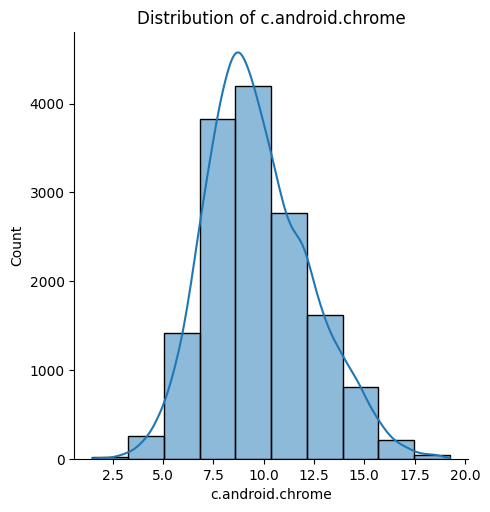

Column: c.android.chrome
  Skewness: 0.44485
  Kurtosis: 0.02005


<Figure size 1000x600 with 0 Axes>

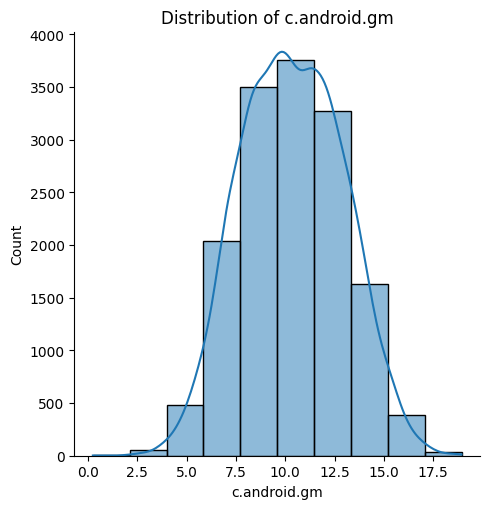

Column: c.android.gm
  Skewness: 0.03816
  Kurtosis: -0.45035


<Figure size 1000x600 with 0 Axes>

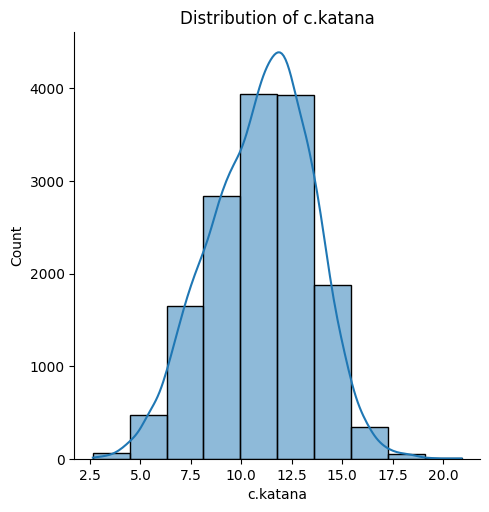

Column: c.katana
  Skewness: -0.19172
  Kurtosis: -0.26695


<Figure size 1000x600 with 0 Axes>

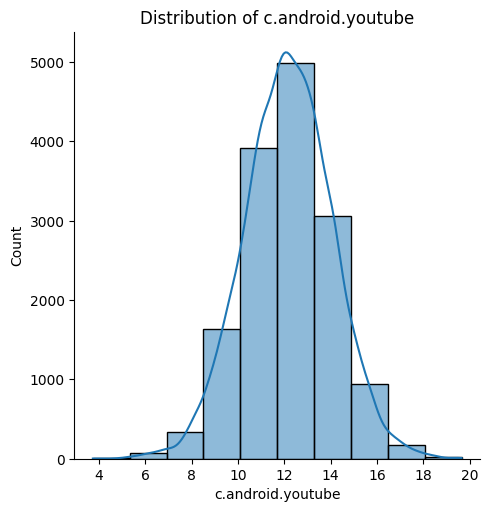

Column: c.android.youtube
  Skewness: -0.03154
  Kurtosis: 0.24499


<Figure size 1000x600 with 0 Axes>

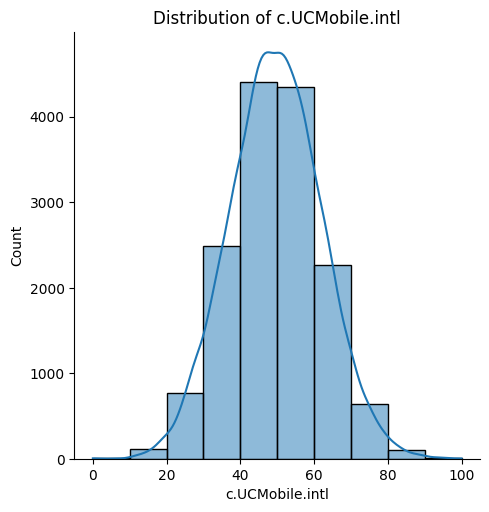

Column: c.UCMobile.intl
  Skewness: 0.04044
  Kurtosis: -0.02499


<Figure size 1000x600 with 0 Axes>

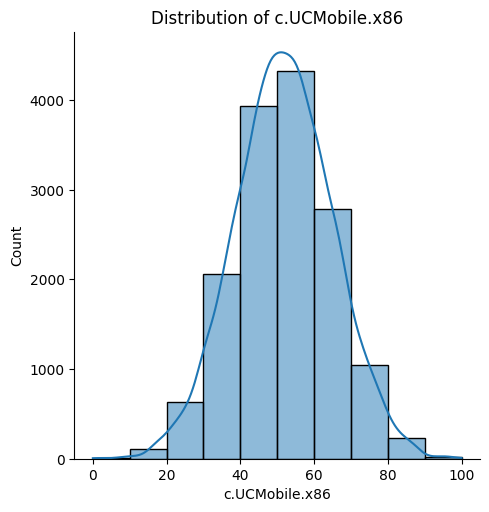

Column: c.UCMobile.x86
  Skewness: 0.00272
  Kurtosis: -0.01034


<Figure size 1000x600 with 0 Axes>

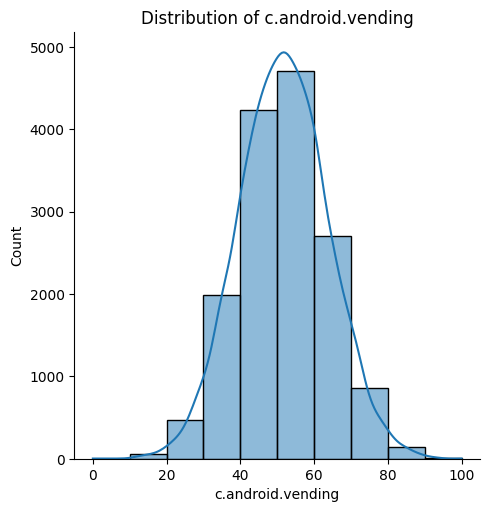

Column: c.android.vending
  Skewness: 0.03123
  Kurtosis: -0.00747


<Figure size 1000x600 with 0 Axes>

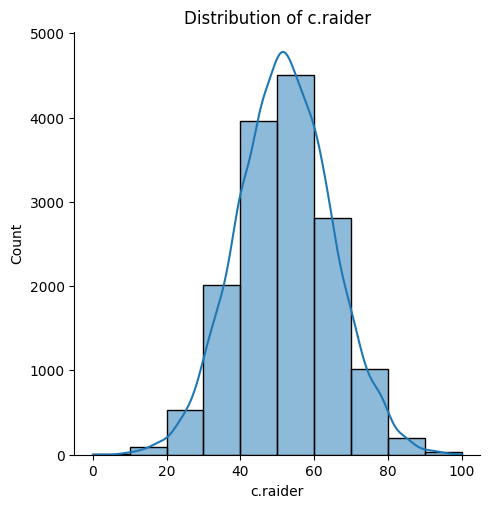

Column: c.raider
  Skewness: 0.02362
  Kurtosis: 0.02216


<Figure size 1000x600 with 0 Axes>

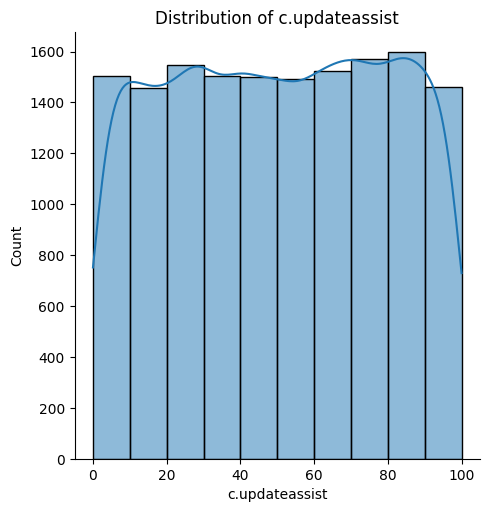

Column: c.updateassist
  Skewness: -0.01975
  Kurtosis: -1.20210


In [10]:
# try to visualise

for col in data_connect.select_dtypes(include=['float64']).columns:
    
    plt.figure(figsize=(10, 6))
    
    sns.displot(data_connect[col], bins=10, kde=True)
    plt.title(f"Distribution of {col}")
    plt.show()

    skewness = stats.skew(data_connect[col])
    kurtosis = stats.kurtosis(data_connect[col])

    print(f"Column: {col}")
    print(f"  Skewness: {skewness:.5f}")
    print(f"  Kurtosis: {kurtosis:.5f}")
    print("="*50)

# most values have kurtios less than 3. This means that its distribution is flatter
# c.updateassist has Nearly uniform distribution

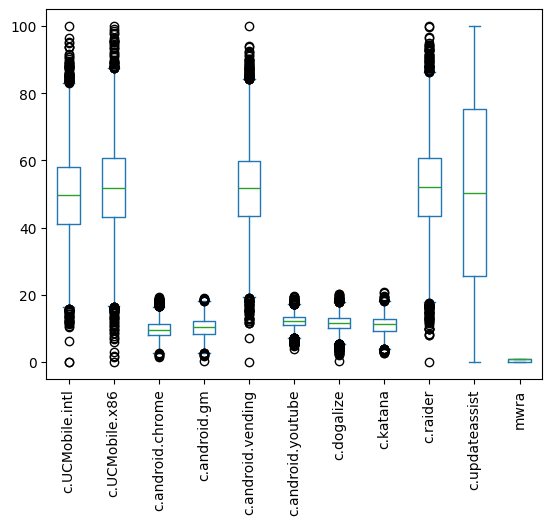

In [11]:
# try to visualise
data_connect[data_connect.columns.difference(['imei'])].plot.box()
plt.xticks(rotation=90)
plt.show()
# we see a lot of outliners in the columns c.UCMobile.intl, c.raider, c.UCMobile.x86
# wide distribution of values in the column c.updateassist

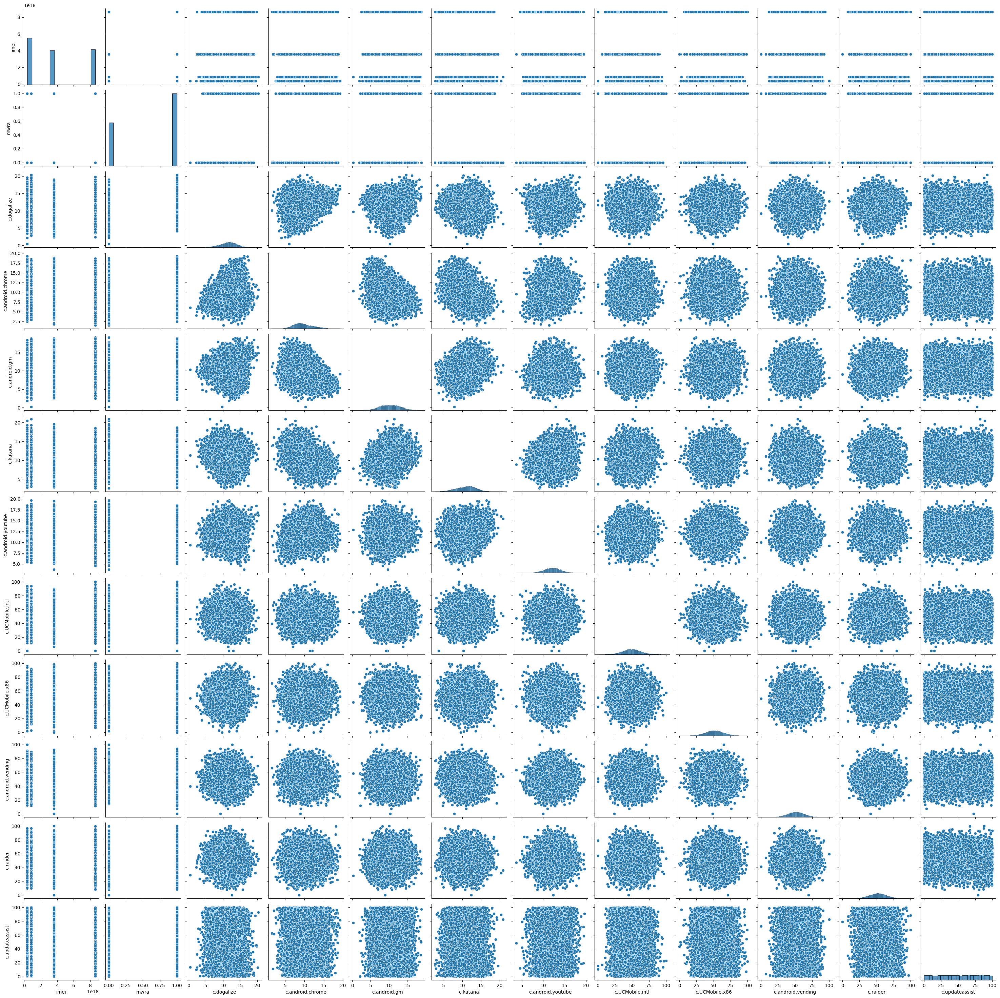

In [12]:
# Párová analýza dát: Identifikujte vzťahy a závislostí medzi dvojicami atribútov.
sns.pairplot(data_connect)

<Axes: >

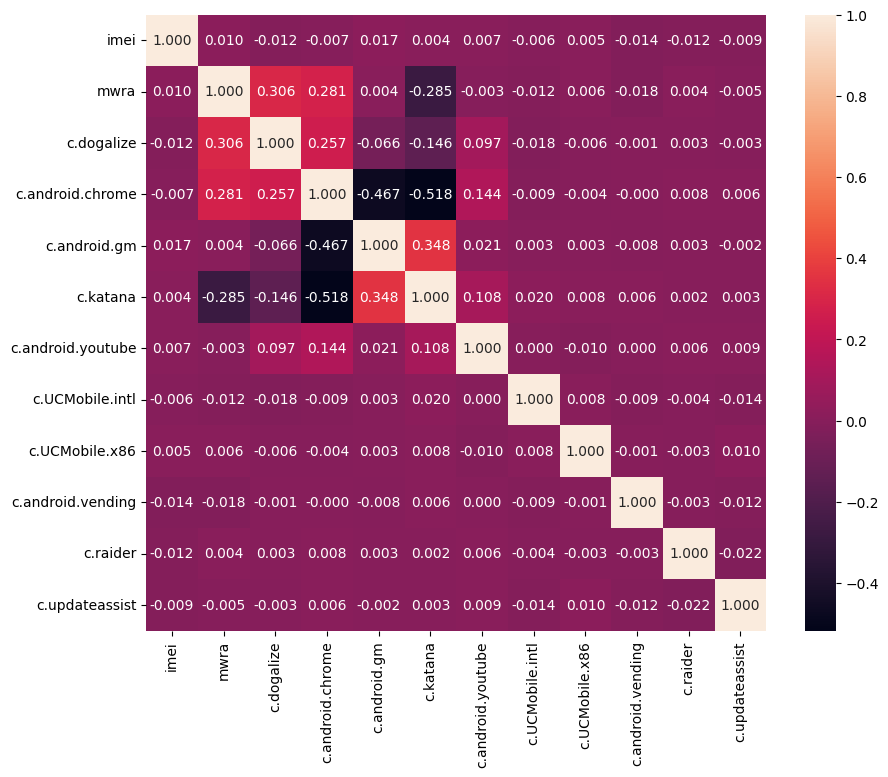

In [13]:
# Párová analýza dát: Identifikujte vzťahy a závislostí medzi dvojicami atribútov.
# try to calculate correlation to now which atributes is more important
fig, ax = plt.subplots(figsize=(10,8))
sns.heatmap(data_connect.corr(numeric_only=True), ax=ax, annot=True, fmt=".3f")

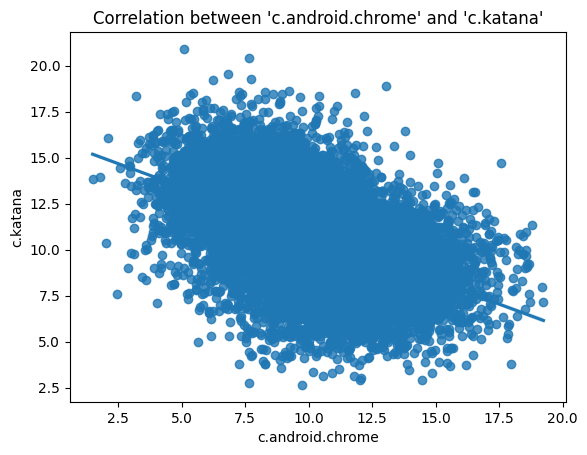

Pearson correlation: -0.518


In [14]:
# let's look at the highest and lowest correlation values in more detail
# from the highest to the lowest
sns.regplot(x="c.android.chrome", y="c.katana", data = data_connect)
plt.title("Correlation between 'c.android.chrome' and 'c.katana'")
plt.show()
print("Pearson correlation: %.3f" % data_connect['c.android.chrome'].corr(data_connect['c.katana']))

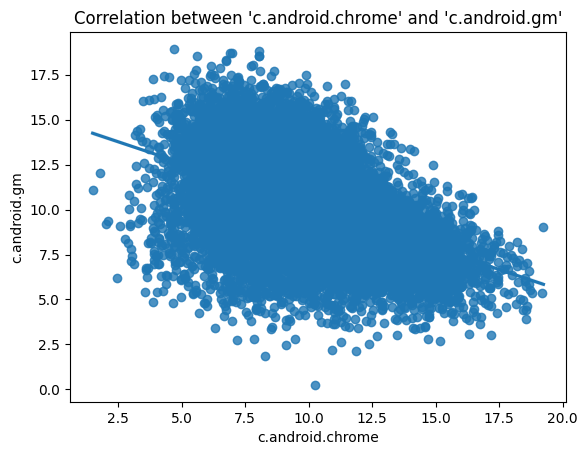

Pearson correlation: -0.467


In [15]:
# let's look at the highest and lowest correlation values in more detail
sns.regplot(x="c.android.chrome", y="c.android.gm", data = data_connect)
plt.title("Correlation between 'c.android.chrome' and 'c.android.gm'")
plt.show()
print("Pearson correlation: %.3f" % data_connect['c.android.chrome'].corr(data_connect['c.android.gm']))

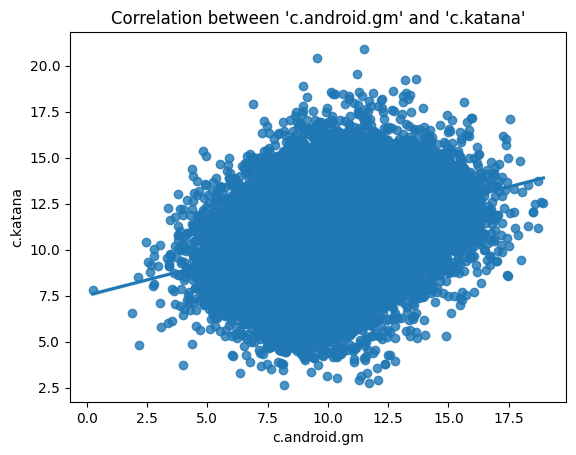

Pearson correlation: 0.348


In [16]:
# let's look at the highest and lowest correlation values in more detail
sns.regplot(x="c.android.gm", y="c.katana", data = data_connect)
plt.title("Correlation between 'c.android.gm' and 'c.katana'")
plt.show()
print("Pearson correlation: %.3f" % data_connect['c.android.gm'].corr(data_connect['c.katana']))

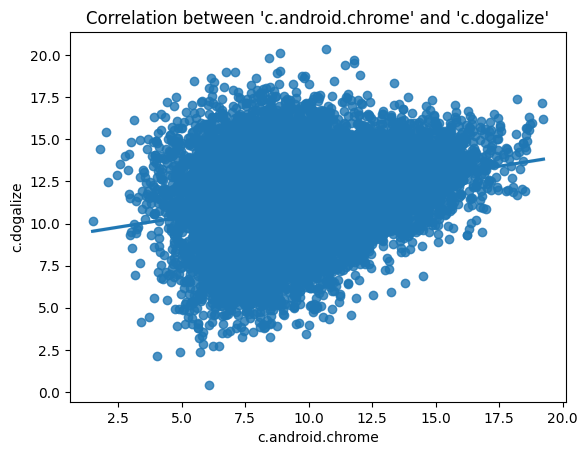

Pearson correlation: 0.257


In [17]:
# let's look at the highest and lowest correlation values in more detail
sns.regplot(x="c.android.chrome", y="c.dogalize", data = data_connect)
plt.title("Correlation between 'c.android.chrome' and 'c.dogalize'")
plt.show()
print("Pearson correlation: %.3f" % data_connect['c.android.chrome'].corr(data_connect['c.dogalize']))

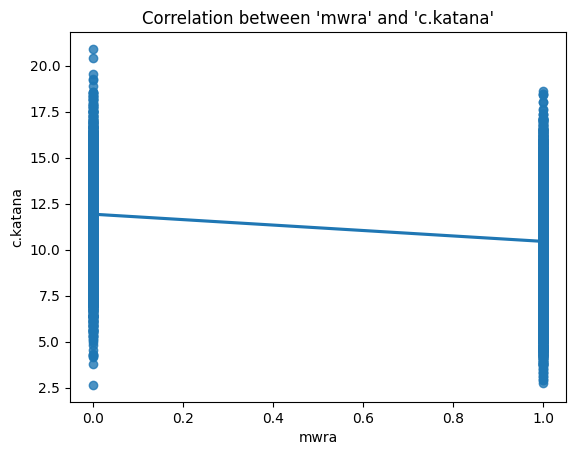

Pearson correlation: -0.285


In [18]:
# let's look at the highest and lowest correlation values in more detail
# I don't see any important correlation there, despite the high score 
sns.regplot(x="mwra", y="c.katana", data = data_connect)
plt.title("Correlation between 'mwra' and 'c.katana'")
plt.show()
print("Pearson correlation: %.3f" % data_connect['mwra'].corr(data_connect['c.katana']))

In [19]:
# Párová analýza dát: Identifikujte závislosti medzi predikovanou premennou a ostatnými premennými (potenciálnymi prediktormi).
target_column =  'mwra'
numeric_data = data_connect.select_dtypes(include=['float64', 'int64'])

correlations = numeric_data.corr()[target_column].sort_values(ascending=False)

print(f"\nCorrelation with the target variable '{target_column}':")
print(correlations)



Correlation with the target variable 'mwra':
mwra                 1.000000
c.dogalize           0.305603
c.android.chrome     0.280960
imei                 0.010248
c.UCMobile.x86       0.006086
c.raider             0.004376
c.android.gm         0.004307
c.android.youtube   -0.002632
c.updateassist      -0.005271
c.UCMobile.intl     -0.011517
c.android.vending   -0.018282
c.katana            -0.284764
Name: mwra, dtype: float64


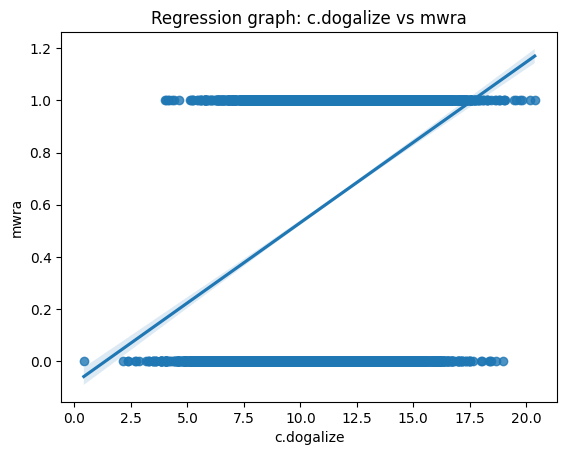

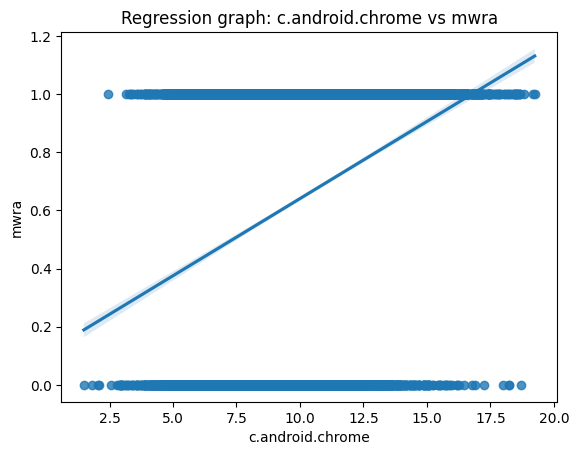

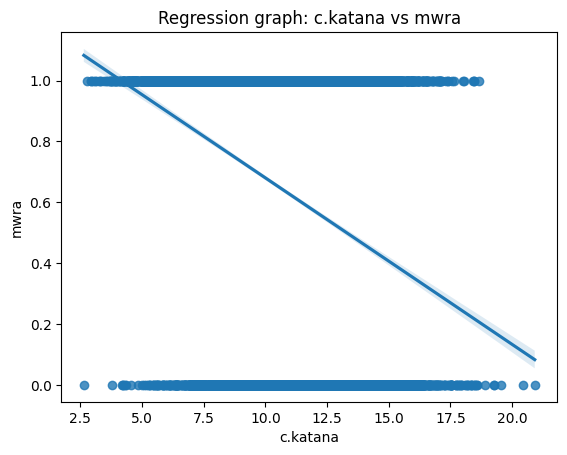

In [20]:
# Párová analýza dát: Identifikujte závislosti medzi predikovanou premennou a ostatnými premennými (potenciálnymi prediktormi).
# I chose to visualise the most indicative dependencies by the correlation value 
import_col = ['c.dogalize','c.android.chrome','c.katana'] 
for col in import_col:
    plt.figure()
    sns.regplot(x=col, y=target_column, data=data_connect)
    plt.title(f"Regression graph: {col} vs {target_column}")
    plt.show()
# from the preliminary analysis of this file
# the attributes 'c.dogalize', 'c.android.chrome', 'c.katana' show a high dependence on each other and possibly 'mwra' depends on them

In [21]:
# Analýza štruktúr dát ako súbory (štruktúry a vzťahy, počet, typy, …), záznamy (štruktúry, počet záznamov, počet atribútov, typy, …)
data_proces = pd.read_csv('../data/processes.csv', sep='\t')
data_proces.head()

,ts,imei,mwra,p.android.chrome,p.android.packageinstaller,p.android.gm,p.system,p.android.settings,p.android.externalstorage,p.android.documentsui,...,p.browser.provider,p.notifier,p.simulator,p.process.gapps,p.gms.persistent,p.android.gms,p.android.vending,p.google,p.dogalize,p.katana
0,2018-05-05 10:00:00,359043379931766924,1.0,12.53394,14.84593,8.28029,12.04131,10.03367,3.35163,9.50967,...,81.39323,57.87350,9.23177,16.46356,93.88323,0.32995,62.37028,15.22778,5.89388,6.03609
1,2018-05-05 10:01:00,8630330696303481206,1.0,10.58285,10.32858,11.38843,8.30903,8.98698,14.29107,12.90644,...,3.05919,57.56739,5.04789,93.31108,27.87581,79.75929,11.07238,70.49777,47.69787,89.49853
2,2018-05-05 10:02:00,3590433799317661792,0.0,11.56498,9.76566,12.35113,9.28264,11.96318,12.90534,8.16690,...,49.76403,13.90722,57.29582,7.50306,42.49943,32.31860,12.76717,17.29317,54.81563,55.71336
3,2018-05-05 10:03:00,863033069630348917,1.0,7.64111,8.16381,7.97117,13.16386,8.60422,8.76321,12.60983,...,76.87083,66.61116,60.82928,63.35781,48.15644,6.31010,98.96592,8.35998,91.28845,13.92498
4,2018-05-05 10:04:00,3590433799317661701,1.0,6.20478,12.58322,8.54453,13.20827,8.79598,8.66913,14.47744,...,99.05288,52.95510,41.17979,92.03150,43.19034,83.83789,11.61636,52.79695,64.04217,54.94188


In [22]:
# Analýza štruktúr dát ako súbory (štruktúry a vzťahy, počet, typy, …), záznamy (štruktúry, počet záznamov, počet atribútov, typy, …)print("Info for profiles.csv:")
print(data_proces.info())
print("Size of dataset:", data_proces.shape)  
print("The number of missing values in each column, %:")
print(round((data_proces.isnull().sum() / len(data_proces)) * 100, 2))
# in this file we see the repetition of fields from the previous one
# A good strategy can be to connect these two files by ts and imei attributes
# there are no empty values here 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15156 entries, 0 to 15155
Data columns (total 23 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ts                          15156 non-null  object 
 1   imei                        15156 non-null  int64  
 2   mwra                        15156 non-null  float64
 3   p.android.chrome            15156 non-null  float64
 4   p.android.packageinstaller  15156 non-null  float64
 5   p.android.gm                15156 non-null  float64
 6   p.system                    15156 non-null  float64
 7   p.android.settings          15156 non-null  float64
 8   p.android.externalstorage   15156 non-null  float64
 9   p.android.documentsui       15156 non-null  float64
 10  p.android.defcontainer      15156 non-null  float64
 11  p.inputmethod.latin         15156 non-null  float64
 12  p.olauncher                 15156 non-null  float64
 13  p.browser.provider          151

In [23]:
# Analýza jednotlivých atribútov: pre zvolené významné atribúty (min 10) analyzujte ich distribúcie a základné deskriptívne štatistiky. 
data_proces.describe()
for col in data_proces.select_dtypes(include ='float64').columns:
    print(f"Atribute: {col}")
    print(f"Mean: {data_proces[col].mean():.2f}")
    print(f"Median: {data_proces[col].median():.2f}")
    print(f"Mode: {data_proces[col].mode().iloc[0]:.2f}")  
    print(f"Std: {data_proces[col].std():.2f}")
    print(f"Var: {data_proces[col].var():.2f}")

Atribute: mwra
Mean: 0.63
Median: 1.00
Mode: 1.00
Std: 0.48
Var: 0.23
Atribute: p.android.chrome
Mean: 11.00
Median: 11.08
Mode: 8.61
Std: 2.54
Var: 6.45
Atribute: p.android.packageinstaller
Mean: 9.73
Median: 9.46
Mode: 7.81
Std: 2.51
Var: 6.29
Atribute: p.android.gm
Mean: 9.81
Median: 9.70
Mode: 6.28
Std: 2.63
Var: 6.93
Atribute: p.system
Mean: 10.92
Median: 11.19
Mode: 8.77
Std: 2.43
Var: 5.90
Atribute: p.android.settings
Mean: 9.19
Median: 9.05
Mode: 6.58
Std: 2.50
Var: 6.25
Atribute: p.android.externalstorage
Mean: 9.80
Median: 9.64
Mode: 5.54
Std: 2.61
Var: 6.79
Atribute: p.android.documentsui
Mean: 10.37
Median: 10.48
Mode: 8.50
Std: 2.61
Var: 6.80
Atribute: p.android.defcontainer
Mean: 0.18
Median: 0.02
Mode: 0.00
Std: 1.54
Var: 2.37
Atribute: p.inputmethod.latin
Mean: 48.02
Median: 48.04
Mode: 19.11
Std: 12.43
Var: 154.41
Atribute: p.olauncher
Mean: 49.46
Median: 49.24
Mode: 0.09
Std: 28.92
Var: 836.51
Atribute: p.browser.provider
Mean: 50.01
Median: 50.36
Mode: 19.09
Std: 28.

<Figure size 1000x600 with 0 Axes>

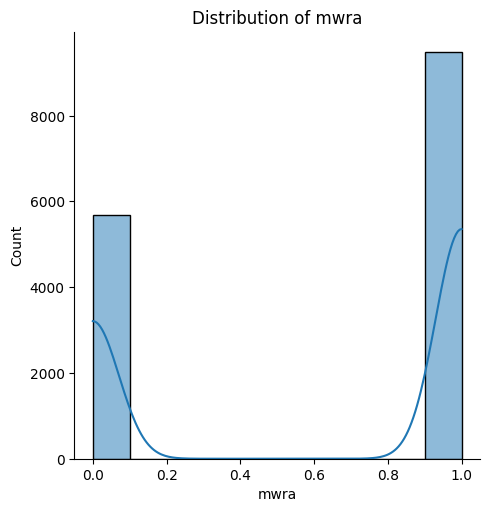

Column: mwra
  Skewness: -0.51800
  Kurtosis: -1.73168


<Figure size 1000x600 with 0 Axes>

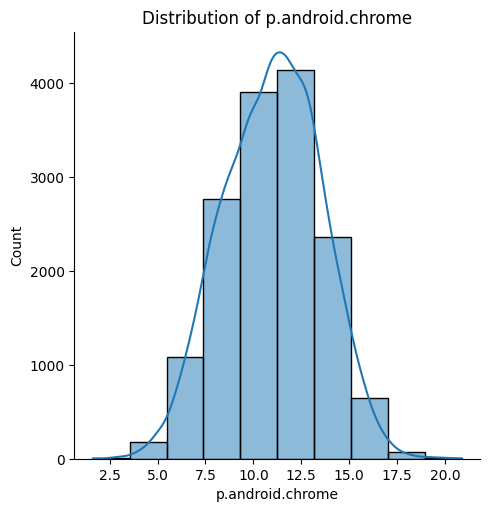

Column: p.android.chrome
  Skewness: -0.07101
  Kurtosis: -0.32506


<Figure size 1000x600 with 0 Axes>

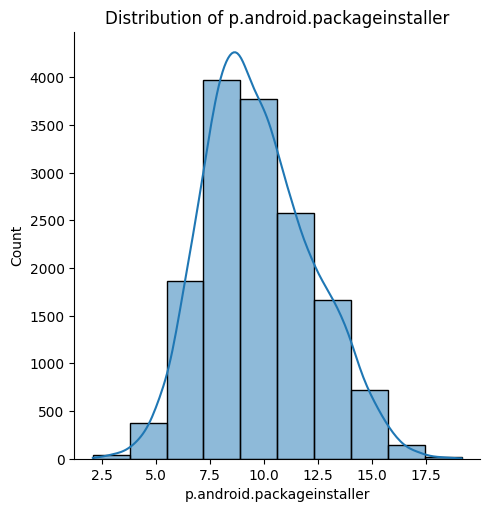

Column: p.android.packageinstaller
  Skewness: 0.34171
  Kurtosis: -0.23176


<Figure size 1000x600 with 0 Axes>

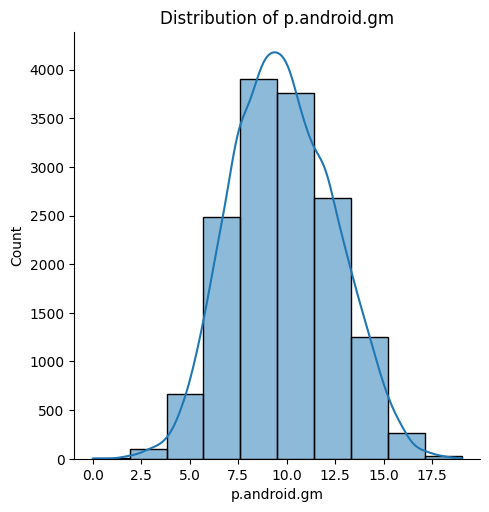

Column: p.android.gm
  Skewness: 0.12322
  Kurtosis: -0.31591


<Figure size 1000x600 with 0 Axes>

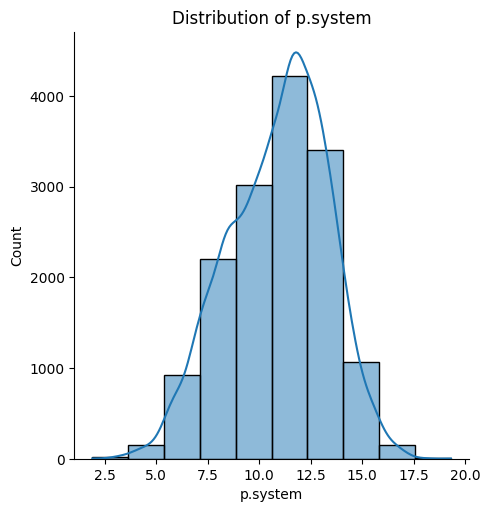

Column: p.system
  Skewness: -0.28366
  Kurtosis: -0.34423


<Figure size 1000x600 with 0 Axes>

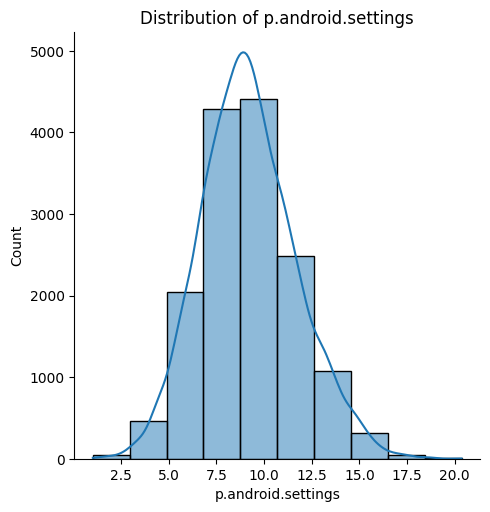

Column: p.android.settings
  Skewness: 0.28438
  Kurtosis: 0.11357


<Figure size 1000x600 with 0 Axes>

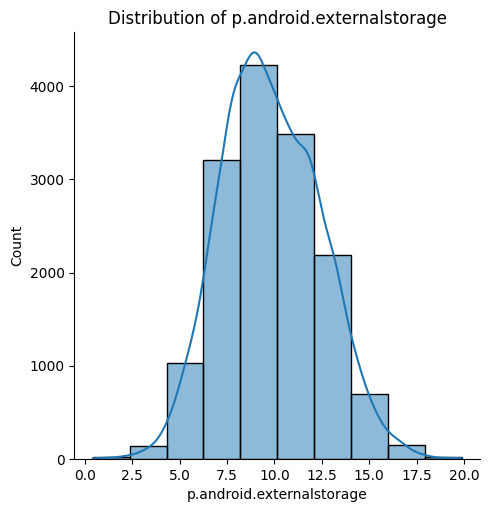

Column: p.android.externalstorage
  Skewness: 0.17860
  Kurtosis: -0.22619


<Figure size 1000x600 with 0 Axes>

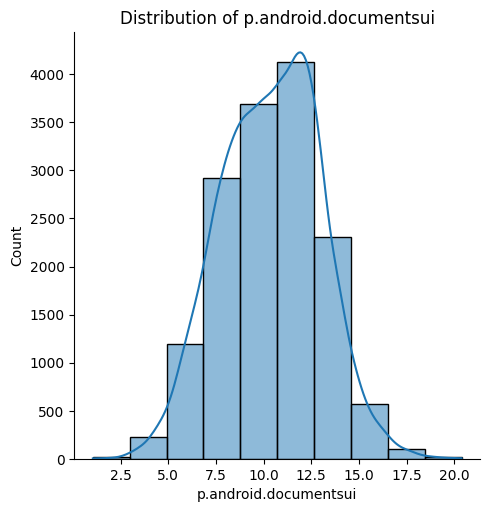

Column: p.android.documentsui
  Skewness: -0.04632
  Kurtosis: -0.27663


<Figure size 1000x600 with 0 Axes>

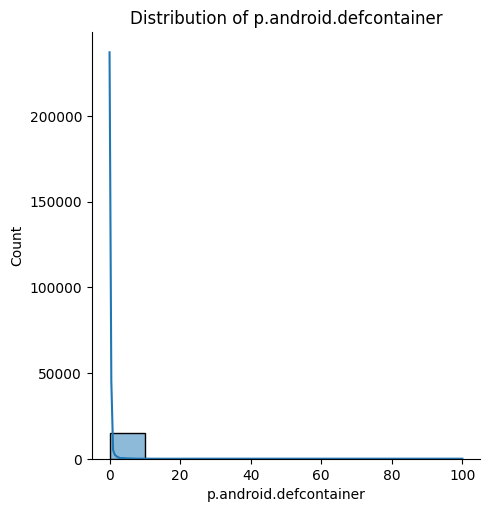

Column: p.android.defcontainer
  Skewness: 38.45296
  Kurtosis: 1968.51092


<Figure size 1000x600 with 0 Axes>

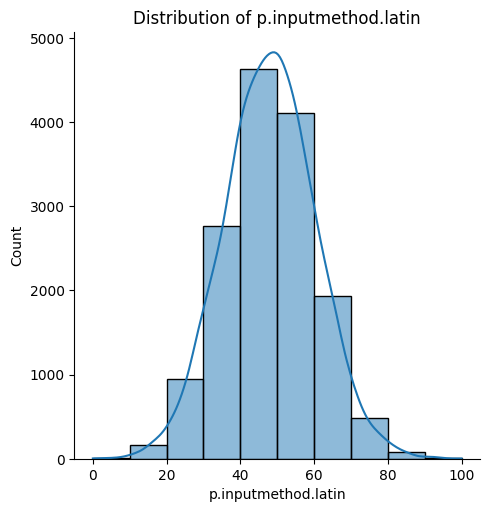

Column: p.inputmethod.latin
  Skewness: 0.03666
  Kurtosis: 0.06594


<Figure size 1000x600 with 0 Axes>

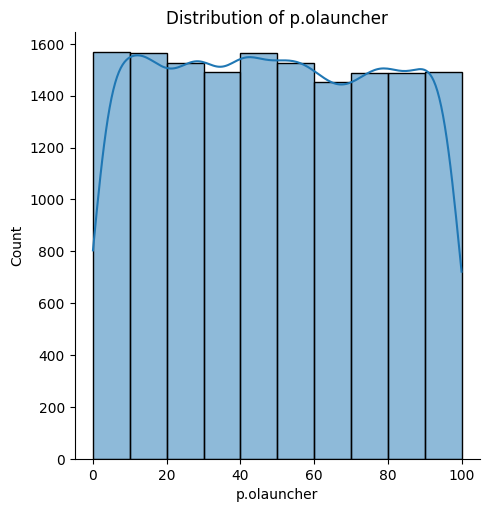

Column: p.olauncher
  Skewness: 0.01854
  Kurtosis: -1.20143


<Figure size 1000x600 with 0 Axes>

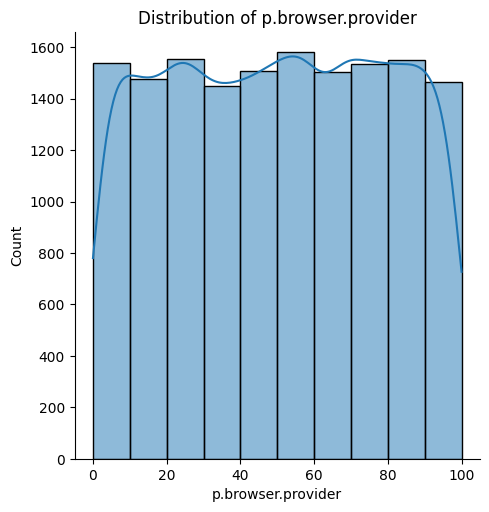

Column: p.browser.provider
  Skewness: -0.01342
  Kurtosis: -1.19907


<Figure size 1000x600 with 0 Axes>

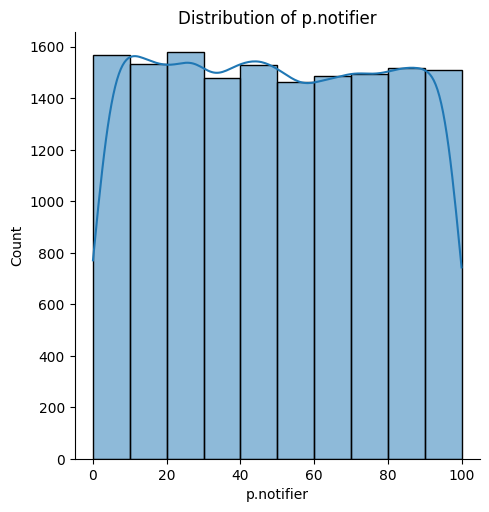

Column: p.notifier
  Skewness: 0.01592
  Kurtosis: -1.21204


<Figure size 1000x600 with 0 Axes>

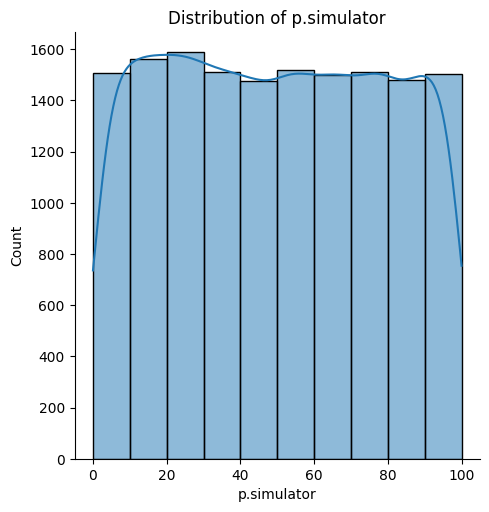

Column: p.simulator
  Skewness: 0.02195
  Kurtosis: -1.21057


<Figure size 1000x600 with 0 Axes>

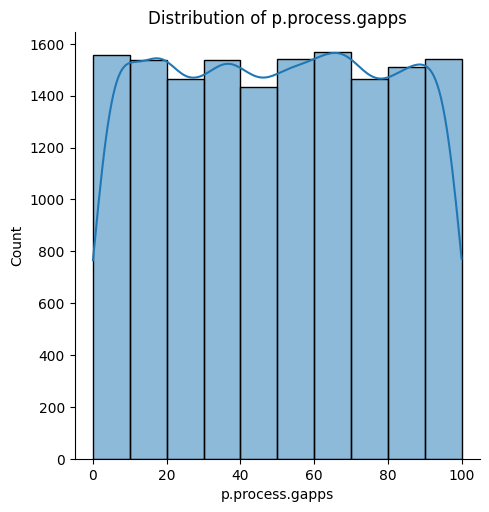

Column: p.process.gapps
  Skewness: -0.00012
  Kurtosis: -1.20519


<Figure size 1000x600 with 0 Axes>

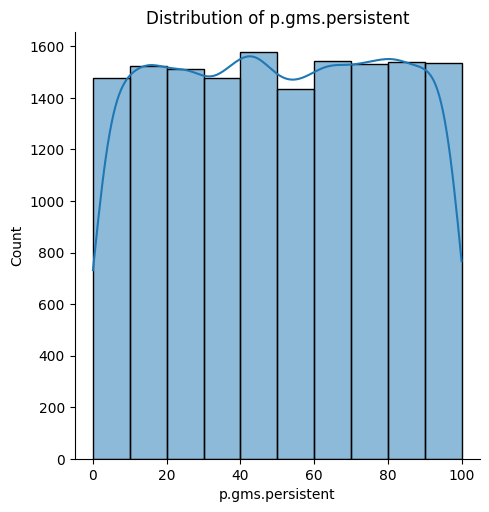

Column: p.gms.persistent
  Skewness: -0.00813
  Kurtosis: -1.20252


<Figure size 1000x600 with 0 Axes>

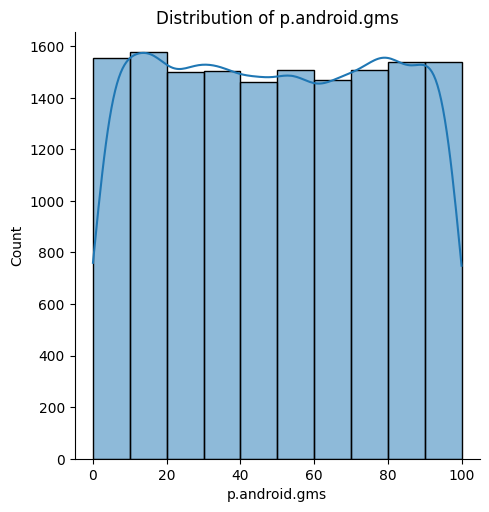

Column: p.android.gms
  Skewness: 0.00638
  Kurtosis: -1.22227


<Figure size 1000x600 with 0 Axes>

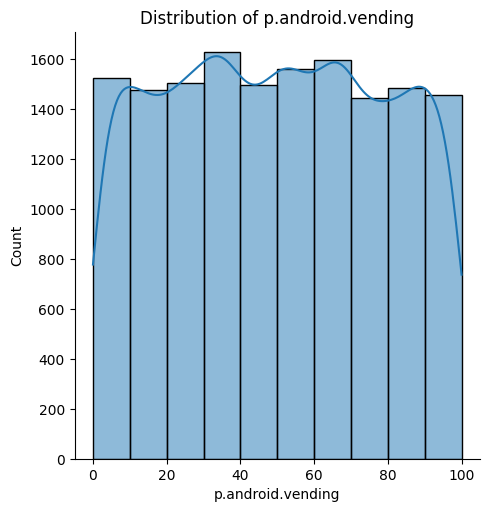

Column: p.android.vending
  Skewness: 0.01080
  Kurtosis: -1.17517


<Figure size 1000x600 with 0 Axes>

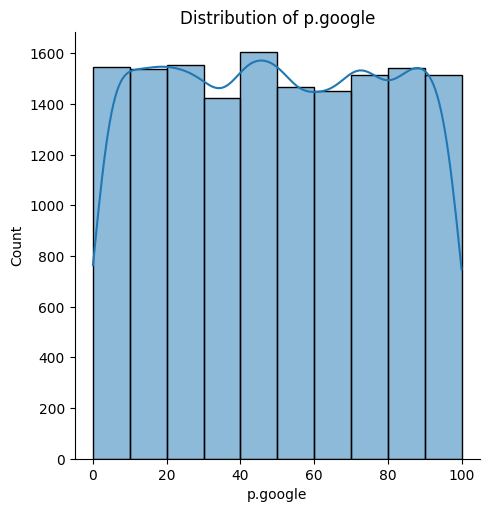

Column: p.google
  Skewness: 0.00838
  Kurtosis: -1.20974


<Figure size 1000x600 with 0 Axes>

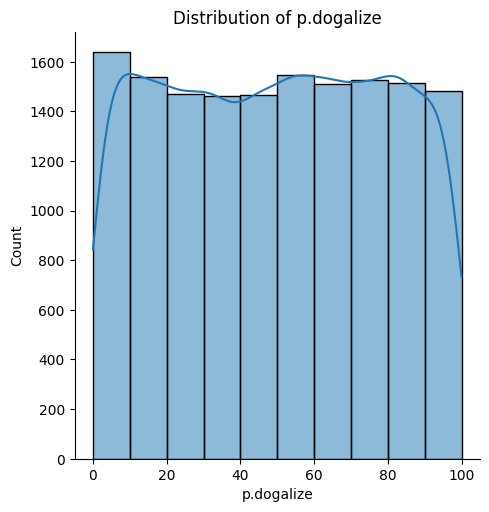

Column: p.dogalize
  Skewness: -0.00643
  Kurtosis: -1.20902


<Figure size 1000x600 with 0 Axes>

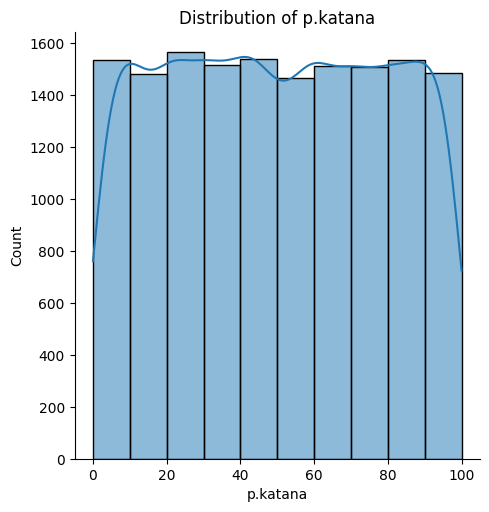

Column: p.katana
  Skewness: 0.00440
  Kurtosis: -1.20535


In [24]:
# try to visualise

for col in data_proces.select_dtypes(include=['float64']).columns:
    
    plt.figure(figsize=(10, 6))
    
    sns.displot(data_proces[col], bins=10, kde=True)
    plt.title(f"Distribution of {col}")
    plt.show()

    skewness = stats.skew(data_proces[col])
    kurtosis = stats.kurtosis(data_proces[col])

    print(f"Column: {col}")
    print(f"  Skewness: {skewness:.5f}")
    print(f"  Kurtosis: {kurtosis:.5f}")
    print("="*50)

# most values have kurtios less than 3. This means that its distribution is flatter
# last 10 atributes has Nearly uniform distribution
# value of atribute c.android.defcontainer is from 0 to 10 in very small range
# all others have slightly higher values on the tails than the normal distribution and slight deviations to the right or left

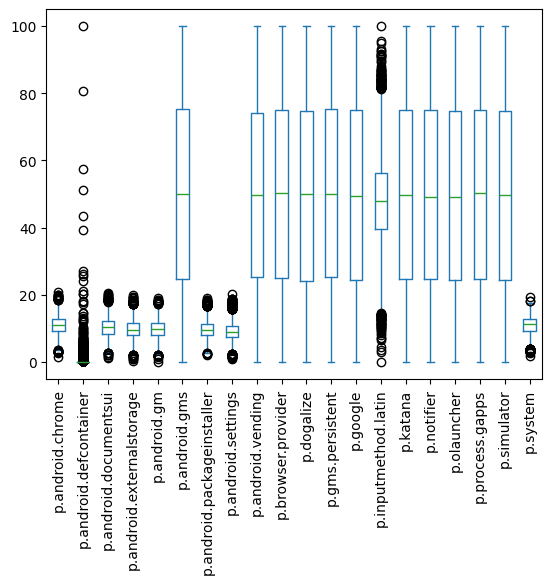

In [25]:
# try to visualise distribution
data_proces[data_proces.columns.difference(['imei', 'mwra'])].plot.box()
plt.xticks(rotation=90)
plt.show()

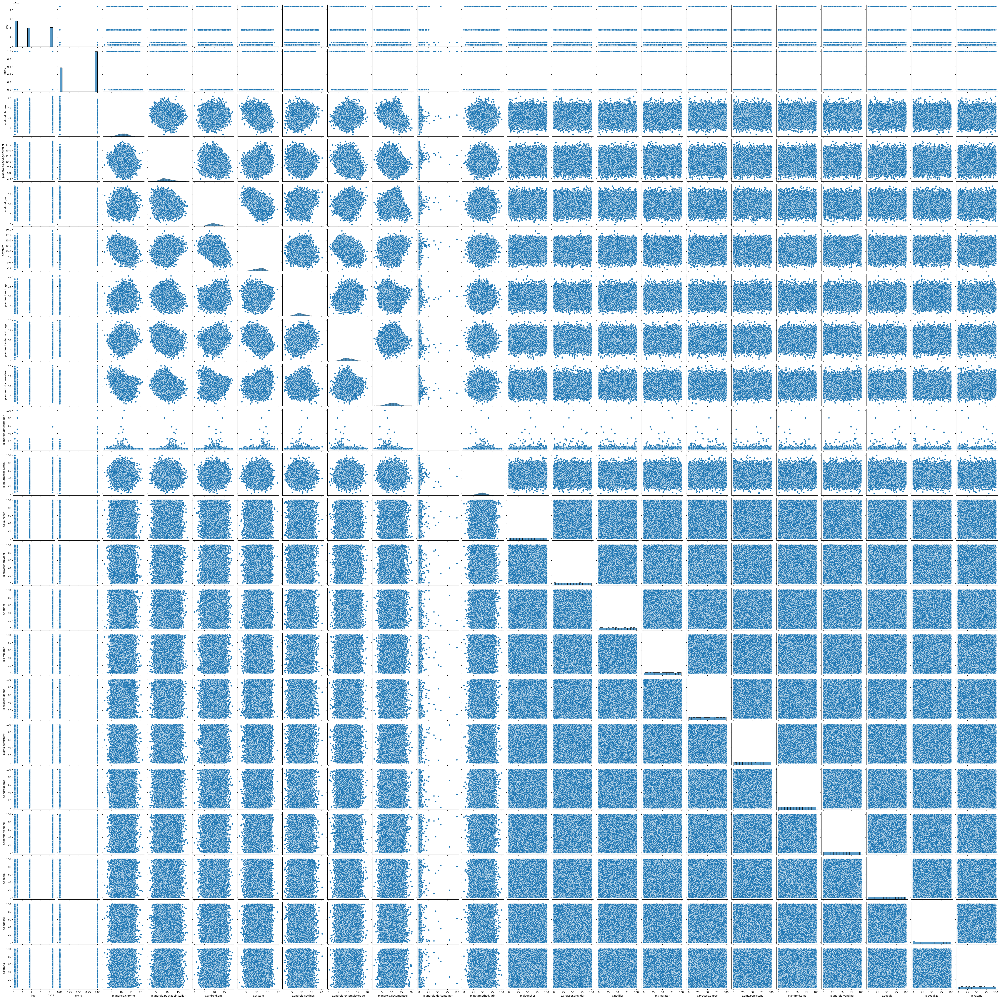

In [26]:
# Párová analýza dát: Identifikujte vzťahy a závislostí medzi dvojicami atribútov.
sns.pairplot(data_proces)
# we see that only up to the 11th column the values are at least somehow correlated,
# so let's take a closer look at this particular gap 

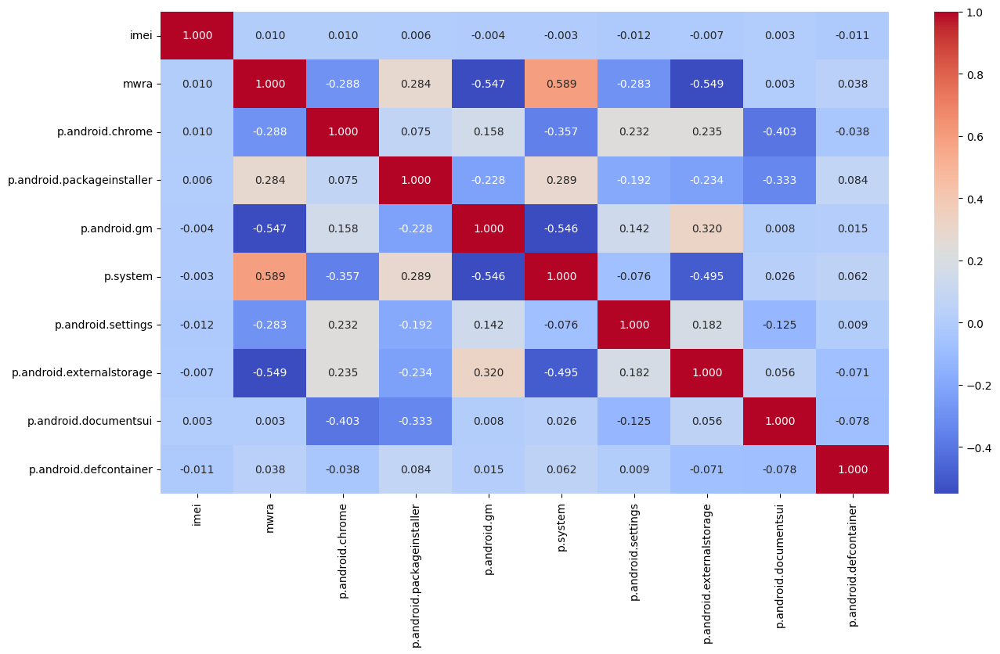

In [27]:
# Párová analýza dát: Identifikujte vzťahy a závislostí medzi dvojicami atribútov.
# try to calculate correlation to now which atributes is more important

subset_columns = data_proces.loc[:, :'p.android.defcontainer']
corr_matrix = subset_columns.corr(numeric_only=True)
fig, ax = plt.subplots(figsize=(15, 8))
sns.heatmap(corr_matrix, ax=ax, annot=True, fmt=".3f", cmap='coolwarm')
plt.show()

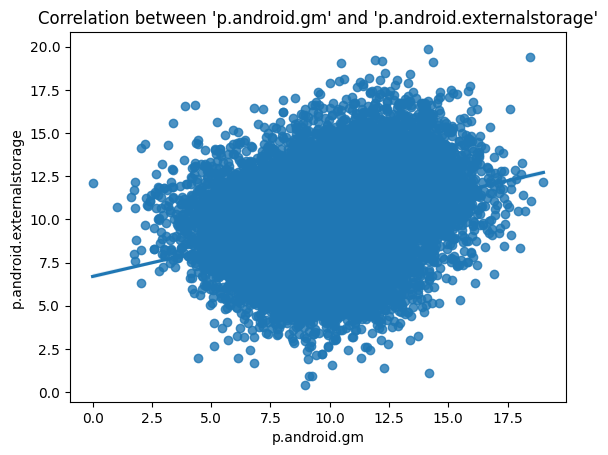

Pearson correlation: 0.320


In [28]:
# let's look at the highest and lowest correlation values in more detail
# from the highest to the lowest
sns.regplot(x="p.android.gm", y="p.android.externalstorage", data = data_proces)
plt.title("Correlation between 'p.android.gm' and 'p.android.externalstorage'")
plt.show()
print("Pearson correlation: %.3f" % data_proces['p.android.gm'].corr(data_proces['p.android.externalstorage']))

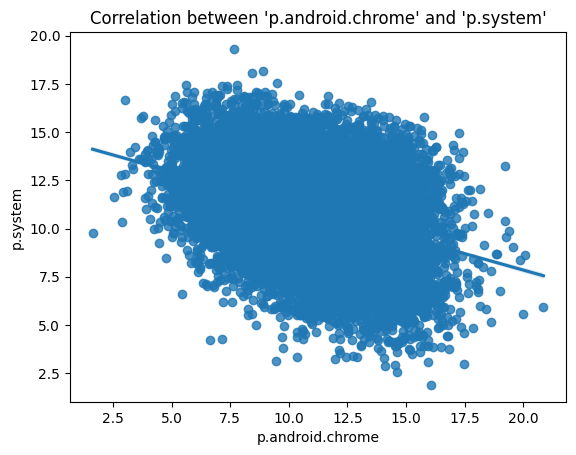

Pearson correlation: -0.357


In [29]:
# let's look at the highest and lowest correlation values in more detail
# from the highest to the lowest
sns.regplot(x="p.android.chrome", y="p.system", data = data_proces)
plt.title("Correlation between 'p.android.chrome' and 'p.system'")
plt.show()
print("Pearson correlation: %.3f" % data_proces['p.android.chrome'].corr(data_proces['p.system']))

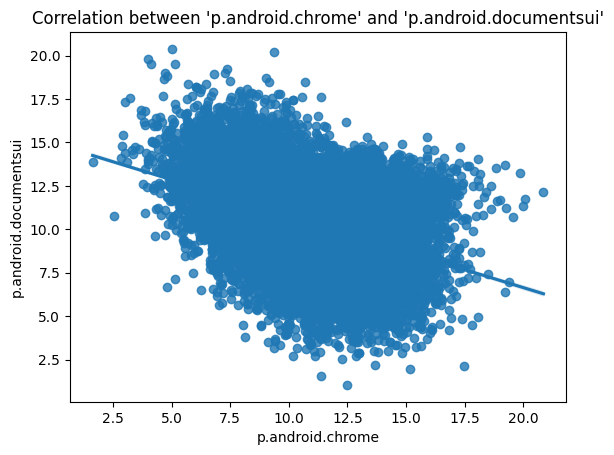

Pearson correlation: -0.403


In [30]:
# let's look at the highest and lowest correlation values in more detail
# from the highest to the lowest
sns.regplot(x="p.android.chrome", y="p.android.documentsui", data = data_proces)
plt.title("Correlation between 'p.android.chrome' and 'p.android.documentsui'")
plt.show()
print("Pearson correlation: %.3f" % data_proces['p.android.chrome'].corr(data_proces['p.android.documentsui']))

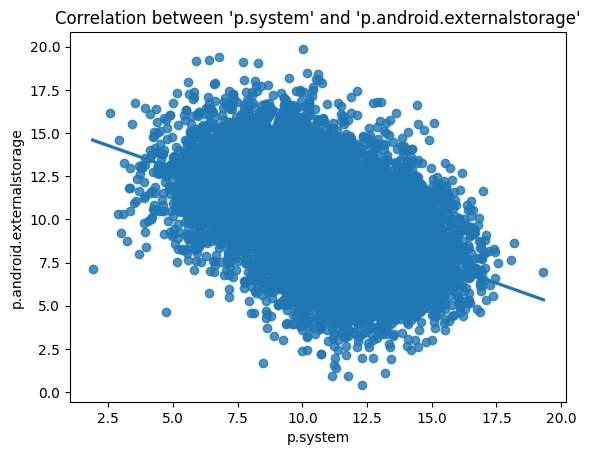

Pearson correlation: -0.495


In [31]:
# let's look at the highest and lowest correlation values in more detail
# from the highest to the lowest
sns.regplot(x="p.system", y="p.android.externalstorage", data = data_proces)
plt.title("Correlation between 'p.system' and 'p.android.externalstorage'")
plt.show()
print("Pearson correlation: %.3f" % data_proces['p.system'].corr(data_proces['p.android.externalstorage']))

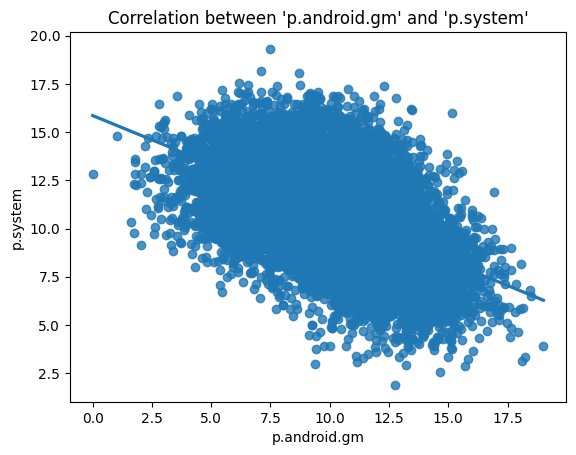

Pearson correlation: -0.546


In [32]:
# let's look at the highest and lowest correlation values in more detail
# from the highest to the lowest
sns.regplot(x="p.android.gm", y="p.system", data = data_proces)
plt.title("Correlation between 'p.android.gm' and 'p.system'")
plt.show()
print("Pearson correlation: %.3f" % data_proces['p.android.gm'].corr(data_proces['p.system']))

In [33]:
# Párová analýza dát: Identifikujte závislosti medzi predikovanou premennou a ostatnými premennými (potenciálnymi prediktormi).
target_column =  'mwra'
numeric_data = data_proces.select_dtypes(include=['float64', 'int64'])

correlations = numeric_data.corr()[target_column].sort_values(ascending=False)

print(f"\nCorrelation with the target variable '{target_column}':")
print(correlations)


Correlation with the target variable 'mwra':
mwra                          1.000000
p.system                      0.588617
p.android.packageinstaller    0.284369
p.android.defcontainer        0.038403
p.browser.provider            0.012218
imei                          0.010248
p.inputmethod.latin           0.009226
p.olauncher                   0.007648
p.gms.persistent              0.004486
p.android.documentsui         0.003091
p.notifier                    0.002818
p.google                      0.001266
p.dogalize                   -0.003183
p.android.vending            -0.003872
p.simulator                  -0.006390
p.android.gms                -0.008271
p.katana                     -0.010533
p.process.gapps              -0.014591
p.android.settings           -0.283416
p.android.chrome             -0.288244
p.android.gm                 -0.546747
p.android.externalstorage    -0.549169
Name: mwra, dtype: float64


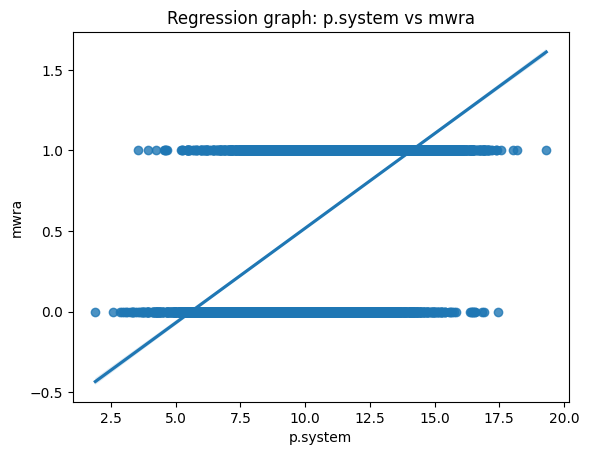

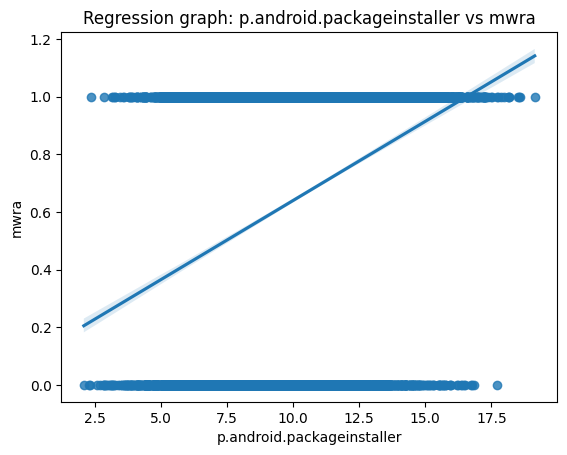

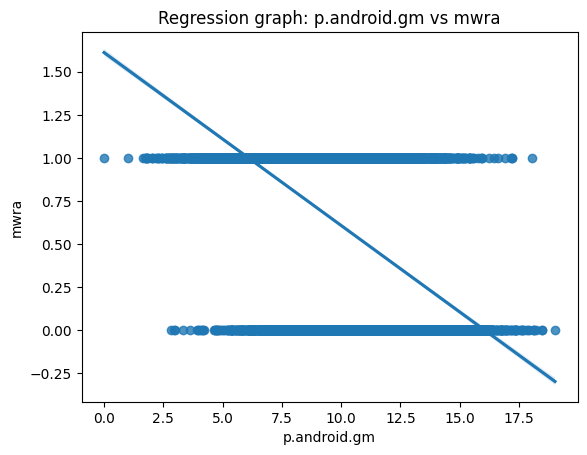

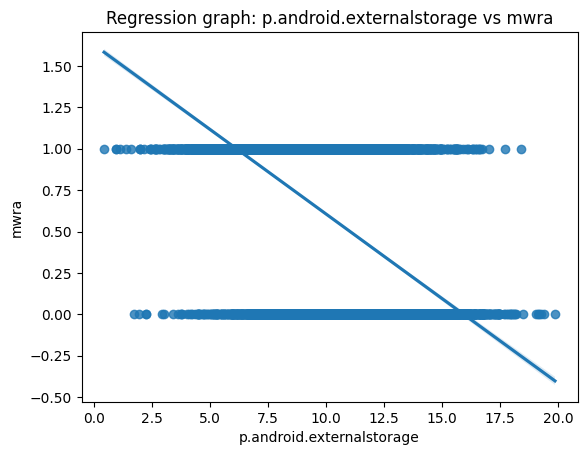

In [34]:
# Párová analýza dát: Identifikujte závislosti medzi predikovanou premennou a ostatnými premennými (potenciálnymi prediktormi).
# I chose to visualise the most indicative dependencies by the correlation value 
# visualize 2 attributes with the highest positive and negative correlation values
import_col = ['p.system','p.android.packageinstaller','p.android.gm','p.android.externalstorage'] 
for col in import_col:
    plt.figure()
    sns.regplot(x=col, y=target_column, data=data_proces)
    plt.title(f"Regression graph: {col} vs {target_column}")
    plt.show()
# from the preliminary analysis of this file
#  possibly 'mwra' depends on the attributes 'p.system','p.android.packageinstaller','p.android.gm','p.android.externalstorage'

In [35]:
# Analýza štruktúr dát ako súbory (štruktúry a vzťahy, počet, typy, …), záznamy (štruktúry, počet záznamov, počet atribútov, typy, …)
data_dev = pd.read_csv('../data/devices.csv', sep='\t')
data_dev.head()
# in this file we also see most of the data about users

,latitude,longitude,store_name,code,location,imei
0,0.76755,24.43973,Yangambi,CD,Africa/Lubumbashi,863033069630348016
1,10.29085,105.75635,Sa Dec,VN,Asia/Ho_Chi_Minh,863033069630348917
2,50.23271,12.87117,Karlovy Vary,CZ,Europe/Prague,8630330696303481412
3,13.56667,-15.60000,Farafenni,GM,Africa/Banjul,3590433799317662246
4,41.77583,140.73667,Hakodate,JP,Asia/Tokyo,3590433799317661776


In [36]:
# Analýza štruktúr dát ako súbory (štruktúry a vzťahy, počet, typy, …), záznamy (štruktúry, počet záznamov, počet atribútov, typy, …)
print("Info for profiles.csv:")
print(data_dev.info())
print("Size of dataset:", data_dev.shape)  
print("The number of missing values in each column, %:")
print(round((data_dev.isnull().sum() / len(data_dev)) * 100, 2))
# it would be a good idea to split the location column into two
# There is no point in analyzing this file in detail, since it contains only coordinates

Info for profiles.csv:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2976 entries, 0 to 2975
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   latitude    2976 non-null   float64
 1   longitude   2976 non-null   float64
 2   store_name  2976 non-null   object 
 3   code        2975 non-null   object 
 4   location    2976 non-null   object 
 5   imei        2976 non-null   int64  
dtypes: float64(2), int64(1), object(3)
memory usage: 139.6+ KB
None
Size of dataset: (2976, 6)
The number of missing values in each column, %:
latitude      0.00
longitude     0.00
store_name    0.00
code          0.03
location      0.00
imei          0.00
dtype: float64


In [37]:
# We determined that it would be appropriate to merge the connection.csv and processes.csv files,
# since both contain data records with user codes and times.
# In these files, we found dependencies between some attributes
# possibly 'mwra' depends on the attributes 'p.system','p.android.packageinstaller','p.android.gm','p.android.externalstorage'(processes.csv) or
# possibly 'mwra' depends on the attributes 'c.dogalize', 'c.android.chrome', 'c.katana'(connections.csv)
# the attributes 'c.dogalize', 'c.android.chrome', 'c.katana' also show a high dependence on each other (connections.csv)